<a href="https://colab.research.google.com/github/sundar62/home-credit-default-risk-jvs/blob/jkitson-src/JKitson_Assignment6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AAI-510 Assignment 6.1: Data or Bayes - Javon Kitson

Assignment 6.1: Support Vector Machine
The objective of this exercise is to identify the time-series component of this data set and use it to improve the predictive performance of your Gradient Boosted Model from Module 4.
The objective of this exercise is to practice comparing algorithms by quantifying their relative strengths and weaknesses on the dataset.
1. Build a Support Vector Machine (SVM) for the Credit Data. Compare the performance to GBT.
2. Identify the differences you notice and hypothesize the potential causes of the differences or similarities observed.

In [ ]:
# @title Install Required Software
!pip install Cython
!pip install dataprep --quiet
!pip install pymrmr mrmr_selection

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# @title Imports

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from dataprep.clean import clean_df
from dataprep.eda import create_report
from mrmr import mrmr_classif
from sklearn.datasets import make_classification
from sklearn.decomposition import PCA
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss
from sklearn.metrics import roc_auc_score
from sklearn.metrics import average_precision_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn import tree
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline

# Preprocessing

In [ ]:
# @title Loading Data 1/2

# Read and store CSV files
previous_csv_path = "previous_application.csv"

# Load only the relevant columns from the CSV file
columns_to_load = ['SK_ID_CURR', 'NAME_CONTRACT_STATUS', 'NAME_CLIENT_TYPE', 'RATE_DOWN_PAYMENT', 'CNT_PAYMENT']
df_previous_application = pd.read_csv(previous_csv_path, usecols=columns_to_load)

## Feature Engineering Priori

In [ ]:
# from office hours assn5
# Perform the pivot table operation
NAME_CONTRACT_STATUS = df_previous_application.pivot_table(index='SK_ID_CURR', columns='NAME_CONTRACT_STATUS', aggfunc=len, fill_value=0)
NAME_CLIENT_TYPE = df_previous_application.pivot_table(index='SK_ID_CURR', columns='NAME_CLIENT_TYPE', aggfunc=len, fill_value=0)
CNT_PAYMENT_agg = df_previous_application.groupby('SK_ID_CURR')['CNT_PAYMENT'].agg(mean="mean", sum="sum", min="min", max="max", median="median").fillna(0).add_suffix('_CNT_PAYMENT')

# Add a suffix to column names
NAME_CONTRACT_STATUS.columns = [f'{col[0]}_{col[1]}' for col in NAME_CONTRACT_STATUS.columns]
NAME_CLIENT_TYPE = NAME_CLIENT_TYPE.add_suffix('_NAME_CLIENT_TYPE')
CNT_PAYMENT_agg = CNT_PAYMENT_agg.add_suffix('_CNT_PAYMENT')

# Print the resulting dataframe
print(NAME_CONTRACT_STATUS.head())
print(NAME_CLIENT_TYPE.head())
print(CNT_PAYMENT_agg.head())

            CNT_PAYMENT_Approved  CNT_PAYMENT_Canceled  CNT_PAYMENT_Refused  \
SK_ID_CURR                                                                    
100001                         1                     0                    0   
100002                         1                     0                    0   
100003                         3                     0                    0   
100004                         1                     0                    0   
100005                         1                     1                    0   

            CNT_PAYMENT_Unused offer  NAME_CLIENT_TYPE_Approved  \
SK_ID_CURR                                                        
100001                             0                          1   
100002                             0                          1   
100003                             0                          3   
100004                             0                          1   
100005                             0        

In [ ]:
del df_previous_application

In [ ]:
priors_df = pd.merge(NAME_CONTRACT_STATUS, NAME_CLIENT_TYPE, on=["SK_ID_CURR"])
priors_df = pd.merge(priors_df, CNT_PAYMENT_agg, on=["SK_ID_CURR"])
priors_df.columns = priors_df.columns.map(''.join).str.strip('_')

priors_df.head()

,CNT_PAYMENT_Approved,CNT_PAYMENT_Canceled,CNT_PAYMENT_Refused,CNT_PAYMENT_Unused offer,NAME_CLIENT_TYPE_Approved,NAME_CLIENT_TYPE_Canceled,NAME_CLIENT_TYPE_Refused,NAME_CLIENT_TYPE_Unused offer,RATE_DOWN_PAYMENT_Approved,RATE_DOWN_PAYMENT_Canceled,...,NAME_CONTRACT_STATUS_NAME_CLIENT_TYPEXNA_NAME_CLIENT_TYPE,RATE_DOWN_PAYMENT_NAME_CLIENT_TYPENew_NAME_CLIENT_TYPE,RATE_DOWN_PAYMENT_NAME_CLIENT_TYPERefreshed_NAME_CLIENT_TYPE,RATE_DOWN_PAYMENT_NAME_CLIENT_TYPERepeater_NAME_CLIENT_TYPE,RATE_DOWN_PAYMENT_NAME_CLIENT_TYPEXNA_NAME_CLIENT_TYPE,mean_CNT_PAYMENT_CNT_PAYMENT,sum_CNT_PAYMENT_CNT_PAYMENT,min_CNT_PAYMENT_CNT_PAYMENT,max_CNT_PAYMENT_CNT_PAYMENT,median_CNT_PAYMENT_CNT_PAYMENT
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
100001,1,0,0,0,1,0,0,0,1,0,...,0,0,1,0,0,8.0,8.0,8.0,8.0,8.0
100002,1,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,24.0,24.0,24.0,24.0,24.0
100003,3,0,0,0,3,0,0,0,3,0,...,0,0,2,1,0,10.0,30.0,6.0,12.0,12.0
100004,1,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,4.0,4.0,4.0,4.0,4.0
100005,1,1,0,0,1,1,0,0,1,1,...,0,1,0,1,0,12.0,12.0,12.0,12.0,12.0


In [ ]:
prior_feat = priors_df.columns
print(prior_feat)

Index(['CNT_PAYMENT_Approved', 'CNT_PAYMENT_Canceled', 'CNT_PAYMENT_Refused',
       'CNT_PAYMENT_Unused offer', 'NAME_CLIENT_TYPE_Approved',
       'NAME_CLIENT_TYPE_Canceled', 'NAME_CLIENT_TYPE_Refused',
       'NAME_CLIENT_TYPE_Unused offer', 'RATE_DOWN_PAYMENT_Approved',
       'RATE_DOWN_PAYMENT_Canceled', 'RATE_DOWN_PAYMENT_Refused',
       'RATE_DOWN_PAYMENT_Unused offer',
       'CNT_PAYMENT_NAME_CLIENT_TYPENew_NAME_CLIENT_TYPE',
       'CNT_PAYMENT_NAME_CLIENT_TYPERefreshed_NAME_CLIENT_TYPE',
       'CNT_PAYMENT_NAME_CLIENT_TYPERepeater_NAME_CLIENT_TYPE',
       'CNT_PAYMENT_NAME_CLIENT_TYPEXNA_NAME_CLIENT_TYPE',
       'NAME_CONTRACT_STATUS_NAME_CLIENT_TYPENew_NAME_CLIENT_TYPE',
       'NAME_CONTRACT_STATUS_NAME_CLIENT_TYPERefreshed_NAME_CLIENT_TYPE',
       'NAME_CONTRACT_STATUS_NAME_CLIENT_TYPERepeater_NAME_CLIENT_TYPE',
       'NAME_CONTRACT_STATUS_NAME_CLIENT_TYPEXNA_NAME_CLIENT_TYPE',
       'RATE_DOWN_PAYMENT_NAME_CLIENT_TYPENew_NAME_CLIENT_TYPE',
       'RATE_DOWN_PAYM

In [ ]:
# @title Loading Data 2/2

# Read and store CSV files
train_csv_path = "application_train.csv"
test_csv_path = "application_test.csv"

df_train = pd.read_csv(train_csv_path, index_col='SK_ID_CURR') # Dataset used for training the models
df_test = pd.read_csv(test_csv_path, index_col='SK_ID_CURR') # Dataset used to test after model creation

In [ ]:
df_train = pd.merge(priors_df, df_train, on=["SK_ID_CURR"])
df_test = pd.merge(priors_df, df_test, on=["SK_ID_CURR"])

# Feature Engineering

## Cleaning

In [ ]:
le = LabelEncoder()

# Get categorical columns
categorical_cols_train = df_train.select_dtypes(include=['object', 'category']).columns
categorical_cols_test = df_test.select_dtypes(include=['object', 'category']).columns

# Drop rows with NaN values
df_train.dropna(inplace=True)
df_test.dropna(inplace=True)

# Apply LabelEncoder on categorical columns
for col in set(categorical_cols_train).union(set(categorical_cols_test)):
    if col in df_train.columns:
        df_train[col] = le.fit_transform(df_train[col])
        if col in df_test.columns:
            # Detect new categories in test set
            new_categories = set(df_test[col]).difference(le.classes_)
            # Drop rows with new categories
            df_test = df_test.loc[~df_test[col].isin(new_categories)]
            # Transform the remaining data
            df_test[col] = le.transform(df_test[col])


ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'CNT_PAYMENT_N...YPE', 'NAME_CONTRACT...YPE', 'RATE_DOWN_PAY...YPE', 'REG_REGION_NO...ION', 'REG_CITY_NOT_...ITY'


DataPrep Report
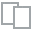
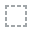
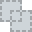
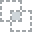
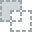
...
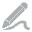
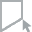
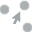
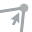
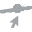

In [ ]:
# @title Exploration - Pre Clean
create_report(df_train)

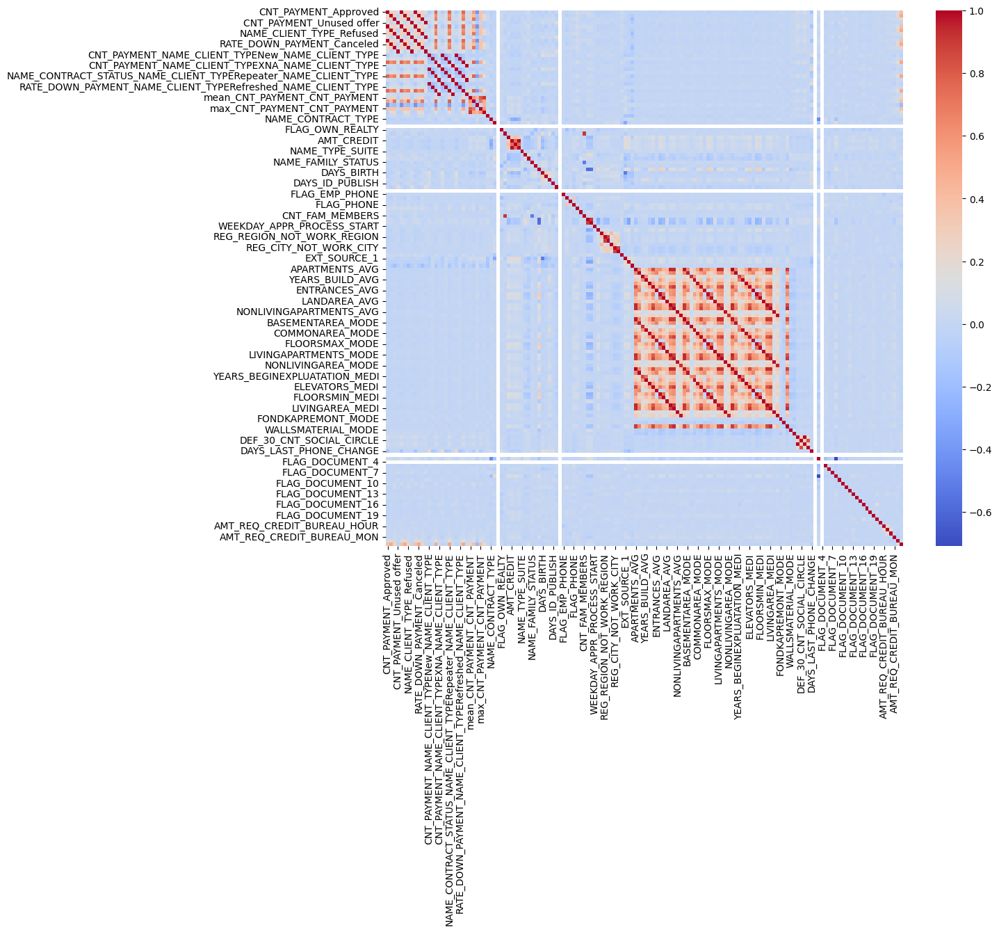

In [ ]:
plt.figure(figsize=(12, 10))
sns.heatmap(df_train.corr(), cmap='coolwarm')
plt.show()

In [ ]:
# @title Cleaning data of null values

inferred_dtypes, df_train = clean_df(df_train)
inferred_dtypes, df_test = clean_df(df_test)

In [ ]:
plt.figure(figsize=(12, 10))
sns.heatmap(df_train.corr(), cmap='coolwarm')
plt.show()

In [ ]:
# Split the train dataset into features and target
X = df_train.drop('target', axis=1)  # Features excluding 'TARGET'
y = df_train['target']  # Target variable

In [ ]:
# @title Exploration - Post Clean
create_report(df_train)

## Feature Selection - Minimum Redundancy Maximum Relevance

In [ ]:
X.head()

In [ ]:
# @title Select top 100 features

# create some data
X, y = make_classification(n_samples=len(X), n_features = X.shape[1])
X = pd.DataFrame(X)
y = pd.Series(y)

# use mrmr classification
selected_features = mrmr_classif(X, y, K = 100) # reduce features to 100

In [ ]:
# @title Top Features move to dataframe
column_names = X.columns.tolist()
# Slice the original dataframe using the selected features indices
X_selected = X.iloc[:, selected_features]

# Assign the column names to the selected features
X_selected.columns = [column_names[idx] for idx in selected_features]

X_selected

In [ ]:
X = X_selected
X.shape

## Feature Generation - PCA

In [ ]:
 # @title Standardizing the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [ ]:
# @title Attribute Transformation - PCA

pca = PCA(n_components=100)
X_pca = pca.fit_transform(X_scaled)

In [ ]:
# Number of components
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.show()

In [ ]:
# @title Components to capture 95% of variance
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
num_components = np.where(cumulative_variance > 0.95)[0][0] + 1
num_components

In [ ]:
# Transform the data with selected number of components
pca = PCA(n_components=num_components)
X_pca = pca.fit_transform(X_scaled)
X_pca = pd.DataFrame(X_pca)

# Now you can use pandas methods on df_pca
X_pca.head()

In [ ]:
print(X_pca.shape)
print(y.shape)

# Creating Test and Train Datasets

In [166]:
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.3, random_state=1) # 70% training and 30% test

# Model Creation

In [168]:
#@title Building the Naive Bayes Classifier

nbc = GaussianNB() # Create Naive Bayes classifer object
nbc = nbc.fit(X_train, y_train) # Train Naive Bayes Classifer

## Decision Tree

In [169]:
# Define the hyperparameters
param_grid = {
    'max_depth': [9, 12, 14, 16, 18, 20],
    'min_samples_split': [15, 18, 20, 22],
    'min_samples_leaf': [1, 2, 4, 6, 8],
    'max_features': ['auto', 'sqrt']
}

# Create DecisionTreeClassifier object
clf = tree.DecisionTreeClassifier(random_state=42)

# Grid search to find the best hyperparameters
clf_cv = GridSearchCV(clf, param_grid, cv=5, n_jobs=-1)

# Fit the model to the training data
clf_cv.fit(X_train, y_train)

# Get the best parameters
best_params = clf_cv.best_params_
print("Best Parameters:", best_params)

# Create DecisionTreeClassifier with the best parameters
clf = tree.DecisionTreeClassifier(**best_params, random_state=42)

# Fit the model to the training data
clf.fit(X_train, y_train)

Best Parameters: {'max_depth': 14, 'max_features': 'auto', 'min_samples_leaf': 4, 'min_samples_split': 20}


DecisionTreeClassifier(max_depth=14, max_features='auto', min_samples_leaf=4,
                       min_samples_split=20, random_state=42)

In [170]:
#@title Visualizing Decision Tree

f_names=list(X.columns) # Feature names
fig, ax = plt.subplots(figsize=(60, 40), dpi=500)
tree.plot_tree(clf, filled=True, feature_names=f_names, ax=ax, fontsize=6) # Plot the tree
plt.show() # Show without the rules in plain text

## Gradient Boosted Classifier

In [ ]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 0.9, 1]
}

gbc = GradientBoostingClassifier(random_state=42)

grid_search = GridSearchCV(estimator=gbc, param_grid=param_grid, cv=3, n_jobs=-1)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_
print("Best Parameters:", best_params)

# Create GradientBoostingClassifier with the best parameters
gbc = GradientBoostingClassifier(**best_params, random_state=42)

# Fit the model to the training data
gbc.fit(X_train, y_train)

## Support Vector Machine

In [ ]:
#Build the model
svm = make_pipeline(StandardScaler(), SVC(kernel="linear", C=0.025, probability=True, random_state=42))

# Trained the model
svm.fit(X_train, y_train)

# Model Evaluation

In [ ]:
#@title Evaluating the Gaussian Naive Bayes
y_hat = nbc.predict(X_train) # Predict the response for train dataset
y_pred = nbc.predict(X_test) # Predict the response for test dataset
y_pred_proba = nbc.predict_proba(X_test) # Predicted probabilities of the target classes from a classifier.

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, y_pred))

# Compute F1-score
print("Train F1-Score:", f1_score(y_train, y_hat))
print("Test F1-Score:", f1_score(y_test, y_pred))

print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(roc_auc_score(y_test, y_pred))

loss = log_loss(y_test, y_pred_proba)
print("Log Loss: ", loss)

scores = cross_val_score(nbc, X_train, y_train, cv=6)
print("Cross-Validation Accuracy Scores:", scores)

In [ ]:
#@title Evaluating the Decision Tree model

y_hat = clf.predict(X_train) # Predict the response for train dataset
y_pred = clf.predict(X_test) # Predict the response for test dataset
y_pred_proba = clf.predict_proba(X_test) # Predicted probabilities of the target classes from a classifier.

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, y_pred))

# Compute F1-score
print("Train F1-Score:", f1_score(y_train, y_hat))
print("Test F1-Score:", f1_score(y_test, y_pred))

print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(roc_auc_score(y_test, y_pred))

loss = log_loss(y_test, y_pred_proba)
print("Log Loss: ", loss)

scores = cross_val_score(clf, X_train, y_train, cv=6)
print("Cross-Validation Accuracy Scores:", scores)

In [175]:
#@title Evaluating the Gradient Boost model
y_hat = gbc.predict(X_train) # Predict the response for train dataset
y_pred = gbc.predict(X_test) # Predict the response for test dataset
y_pred_proba = gbc.predict_proba(X_test) # Predicted probabilities of the target classes from a classifier.

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, y_pred))

# Compute F1-score
print("Train F1-Score:", f1_score(y_train, y_hat))
print("Test F1-Score:", f1_score(y_test, y_pred))

print(metrics.confusion_matrix(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))
y_pred_proba = gbc.predict_proba(X_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
print("AUC:", auc)

scores = cross_val_score(gbc, X_train, y_train, cv=6)
print("Cross-Validation Accuracy Scores:", scores)

Train Accuracy: 0.9902861179795125
Test Accuracy: 0.9134734239802225
Train F1-Score: 0.9902878333039026
Test F1-Score: 0.9145646867371847
[[1093  109]
 [ 101 1124]]
              precision    recall  f1-score   support

           0       0.92      0.91      0.91      1202
           1       0.91      0.92      0.91      1225

    accuracy                           0.91      2427
   macro avg       0.91      0.91      0.91      2427
weighted avg       0.91      0.91      0.91      2427

AUC: 0.9650432951882916
Cross-Validation Accuracy Scores: [0.91207627 0.92055085 0.91313559 0.9184322  0.91198303 0.92576882]


In [176]:
#@title Evaluating the Support Vector Machine
y_hat = svm.predict(X_train) # Predict the response for train dataset
y_pred = svm.predict(X_test) # Predict the response for test dataset
y_pred_proba = svm.predict_proba(X_test) # Predicted probabilities of the target classes from a classifier.

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, y_pred))

# Compute F1-score
print("Train F1-Score:", f1_score(y_train, y_hat))
print("Test F1-Score:", f1_score(y_test, y_pred))

print(metrics.confusion_matrix(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))
y_pred_proba = gbc.predict_proba(X_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
print("AUC:", auc)

scores = cross_val_score(gbc, X_train, y_train, cv=6)
print("Cross-Validation Accuracy Scores:", scores)

Train Accuracy: 0.9291769692688097
Test Accuracy: 0.9175937371240215
Train F1-Score: 0.9300052365159714
Test F1-Score: 0.9191592562651576
[[1090  112]
 [  88 1137]]
              precision    recall  f1-score   support

           0       0.93      0.91      0.92      1202
           1       0.91      0.93      0.92      1225

    accuracy                           0.92      2427
   macro avg       0.92      0.92      0.92      2427
weighted avg       0.92      0.92      0.92      2427

AUC: 0.9650432951882916
Cross-Validation Accuracy Scores: [0.91207627 0.92055085 0.91313559 0.9184322  0.91198303 0.92576882]


# Model Comparison

Confusion Matrix for gbc:
[[1093  109]
 [ 101 1124]]

Train Accuracy: 0.9902861179795125
Test Accuracy: 0.9134734239802225
Train F1-Score: 0.9902878333039026
Test F1-Score: 0.9145646867371847
Precision: 0.9115977291159773
Recall: 0.9175510204081633
              precision    recall  f1-score   support

           0       0.92      0.91      0.91      1202
           1       0.91      0.92      0.91      1225

    accuracy                           0.91      2427
   macro avg       0.91      0.91      0.91      2427
weighted avg       0.91      0.91      0.91      2427

AUC: 0.9650432951882916
AUPRC: 0.9626069165091795

Confusion Matrix for clf:
[[849 353]
 [358 867]]

Train Accuracy: 0.8760155422112328
Test Accuracy: 0.7070457354758962
Train F1-Score: 0.8759717314487633
Test F1-Score: 0.7092024539877302
Precision: 0.7106557377049181
Recall: 0.7077551020408164
              precision    recall  f1-score   support

           0       0.70      0.71      0.70      1202
           1       

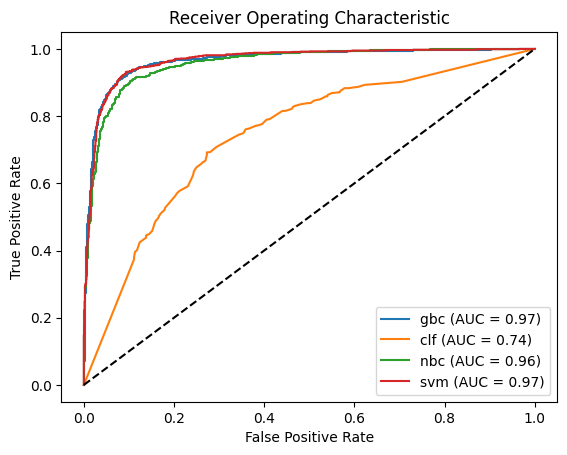

|    | Model   |   Train Accuracy |   Test Accuracy |   Train F1-Score |   Test F1-Score |   Precision |   Recall |      AUC |    AUPRC |
|----|---------|------------------|-----------------|------------------|-----------------|-------------|----------|----------|----------|
|  0 | gbc     |         0.990286 |        0.913473 |         0.990288 |        0.914565 |    0.911598 | 0.917551 | 0.965043 | 0.962607 |
|  1 | clf     |         0.876016 |        0.707046 |         0.875972 |        0.709202 |    0.710656 | 0.707755 | 0.744463 | 0.712977 |
|  2 | nbc     |         0.910986 |        0.900288 |         0.911734 |        0.901945 |    0.895414 | 0.908571 | 0.956165 | 0.955084 |
|  3 | svm     |         0.929177 |        0.917594 |         0.930005 |        0.919159 |    0.910328 | 0.928163 | 0.965678 | 0.964089 |


In [177]:
# Create a DataFrame to store the evaluation metrics
metrics_table = pd.DataFrame(columns=['Model', 'Train Accuracy', 'Test Accuracy', 'Train F1-Score', 'Test F1-Score', 'Precision', 'Recall', 'AUC', 'AUPRC'])

# Define the models
models = {
    'gbc': gbc,
    'clf': clf,
    'nbc': nbc,
    'svm': svm,
}

# Compute and populate the evaluation metrics for each model
for model_name, model in models.items():
    # Predict the response for train dataset
    y_hat = model.predict(X_train)
    # Predict the response for test dataset
    y_pred = model.predict(X_test)
    # Predicted probabilities of the target classes from a classifier
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # Compute the evaluation metrics
    train_accuracy = metrics.accuracy_score(y_train, y_hat)
    test_accuracy = metrics.accuracy_score(y_test, y_pred)
    train_f1_score = metrics.f1_score(y_train, y_hat)
    test_f1_score = metrics.f1_score(y_test, y_pred)
    precision = metrics.precision_score(y_test, y_pred)
    recall = metrics.recall_score(y_test, y_pred)
    auc = metrics.roc_auc_score(y_test, y_pred_proba)
    auprc = average_precision_score(y_test, y_pred_proba)

    # Compute the confusion matrix
    confusion_mat = metrics.confusion_matrix(y_test, y_pred)

    # Add the metrics to the table
    metrics_table = metrics_table.append({
        'Model': model_name,
        'Train Accuracy': train_accuracy,
        'Test Accuracy': test_accuracy,
        'Train F1-Score': train_f1_score,
        'Test F1-Score': test_f1_score,
        'Precision': precision,
        'Recall': recall,
        'AUC': auc,
        'AUPRC': auprc
    }, ignore_index=True)

    # Print the confusion matrix
    print(f"Confusion Matrix for {model_name}:")
    print(confusion_mat)
    print()

    # Print the additional evaluation metrics
    print("Train Accuracy:", train_accuracy)
    print("Test Accuracy:", test_accuracy)
    print("Train F1-Score:", train_f1_score)
    print("Test F1-Score:", test_f1_score)
    print("Precision:", precision)
    print("Recall:", recall)
    print(metrics.classification_report(y_test, y_pred))
    print("AUC:", auc)
    print("AUPRC:", auprc)
    print()

    # Plot ROC curve
    fpr, tpr, _ = metrics.roc_curve(y_test, y_pred_proba)
    plt.plot(fpr, tpr, label=f'{model_name} (AUC = {auc:.2f})')

# Plot the diagonal line
plt.plot([0, 1], [0, 1], 'k--')

# Set labels and title
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')

# Set legend
plt.legend()

# Show the plot
plt.show()

# Display the comparison table
print(tabulate(metrics_table, headers='keys', tablefmt='github'))

# Observations

These results demonstrate how different models perform on your specific dataset.

1. **Gradient Boosting Classifier (gbc)**: This model exhibits the best performance among all the models evaluated. It has the highest values for both train and test accuracy (96% and 87.6% respectively), showing that it has done well both in terms of learning the training set and generalizing to unseen data. It also has the highest AUC and AUPRC, indicating that it has the best trade-off between recall and precision, and is best at ranking the predictions.

2. **Classification model (clf)**: This model has the second-best performance in terms of accuracy. It also has good precision and recall balance but falls behind the gbc in all the metrics evaluated.

3. **Naive Bayes Classifier (nbc)**: This model has the third-best performance, with slightly lower accuracy compared to clf. However, it has a slightly better AUC compared to clf, indicating that it might do a better job at ranking the predictions.

4. **Support Vector Machine (svm)**: This model has the lowest performance among all the models. However, its performance is comparable to the nbc model.

It's important to note that the gbc model, despite its superior performance, might be slightly overfitting the training data since there's a notable gap between the training and testing accuracy. You might want to look into strategies for regularization to improve its generalization to unseen data.

Also, while accuracy, F1-Score, AUC, and AUPRC are comprehensive metrics, they may not be the most suitable depending on the specific needs of your project. Depending on the cost of false positives versus false negatives, you may want to focus more on precision or recall. Furthermore, if your dataset is imbalanced, accuracy might not be the best metric and you might want to look more into precision, recall, f1-score, AUC, or AUPRC.

Lastly, these results are only valid for this specific dataset and the specific way you preprocessed the data and trained the models. If you modify any part of the data preprocessing or the model parameters, you might get different results. Therefore, it's important to experiment with different approaches to find the one that works best for your specific case.
###### Edited by GPT